In [0]:
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (10,10)
mpl.rcParams['axes.grid'] = False

import numpy as np
from PIL import Image
import time
import functools

In [0]:
import tensorflow as tf
import tensorflow.contrib.eager as tfe

from tensorflow.python.keras.preprocessing import image as kp_image
from tensorflow.python.keras import models 
from tensorflow.python.keras import losses
from tensorflow.python.keras import layers
from tensorflow.python.keras import backend as K

In [4]:
tf.enable_eager_execution()
print("Eager execution: {}".format(tf.executing_eagerly()))

Eager execution: True


## Visualize input

In [0]:
# Set up some global values here
content_path = 'img/content_img/Green_Sea_Turtle_grazing_seagrass.jpg'
style_path = 'img/style_img/The_Great_Wave_off_Kanagawa.jpg'

In [0]:
def load_img(path_to_img):
    max_dim = 512
    img = Image.open(path_to_img)
    long = max(img.size)
    scale = max_dim/long
    img = img.resize((round(img.size[0]*scale), round(img.size[1]*scale)), Image.ANTIALIAS)

    img = kp_image.img_to_array(img)

    # We need to broadcast the image array such that it has a batch dimension 
    img = np.expand_dims(img, axis=0)
    return img

In [0]:
def imshow(img, title=None):
    # Remove the batch dimension
    out = np.squeeze(img, axis=0)
    # Normalize for display 
    out = out.astype('uint8')
    plt.imshow(out)
    if title is not None:
        plt.title(title)
        plt.imshow(out)

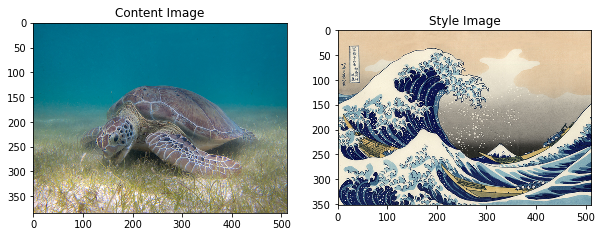

In [8]:
plt.figure(figsize=(10,10))

content = load_img(content_path).astype('uint8')
style = load_img(style_path).astype('uint8')

plt.subplot(1, 2, 1)
imshow(content, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style, 'Style Image')
plt.show()

In [9]:
print(np.shape(content))
print(np.shape(style))

(1, 384, 512, 3)
(1, 353, 512, 3)


In [10]:
import os
os.getcwd()

'C:\\Users\\Tianye Wang\\Google 云端硬盘\\CSCI6908\\DL_Project_TW\\project'

## Prepare the data

In [0]:
def load_and_process_img(path_to_img):
    img = load_img(path_to_img)
    #img = tf.keras.applications.vgg19.preprocess_input(img)
    img = tf.keras.applications.vgg19.preprocess_input(img)
    return img

In [0]:
def deprocess_img(processed_img):
    x = processed_img.copy()
    if len(x.shape) == 4:
        x = np.squeeze(x, 0)
        assert len(x.shape) == 3, ("Input to deprocess image must be an image of "
                             "dimension [1, height, width, channel] or [height, width, channel]")
    if len(x.shape) != 3:
        raise ValueError("Invalid input to deprocessing image")

    # perform the inverse of the preprocessiing step
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    x = x[:, :, ::-1]

    x = np.clip(x, 0, 255).astype('uint8')
    return x

## Define content and style representations


Specifically we’ll pull out these intermediate layers from our network: 

In [13]:
vgg_model = tf.keras.applications.vgg19.VGG19(include_top=True)
vgg_model.summary()

Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
bloc

#### configuration:

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

## Bulid the model

In [0]:
def get_model():
    """ Creates our model with access to intermediate layers. 

    This function will load the VGG19 model and access the intermediate layers. 
    These layers will then be used to create a new model that will take input image
    and return the outputs from these intermediate layers from the VGG model. 

    Returns:
    returns a keras model that takes image inputs and outputs the style and 
      content intermediate layers. 
    """
    # Load our model. We load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.vgg19.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False
    # Get output layers corresponding to style and content layers 
    style_outputs = [vgg.get_layer(name).output for name in style_layers]
    content_outputs = [vgg.get_layer(name).output for name in content_layers]
    model_outputs = style_outputs + content_outputs
    # Build model 
    return models.Model(vgg.input, model_outputs)

## Content loss

In [0]:
def get_content_loss(base_content, target):
      return tf.reduce_mean(tf.square(base_content - target))

## Style Loss

In [0]:
def gram_matrix(input_tensor):
    # We make the image channels first 
    channels = int(input_tensor.shape[-1])
    a = tf.reshape(input_tensor, [-1, channels])
    n = tf.shape(a)[0]
    gram = tf.matmul(a, a, transpose_a=True)
    return gram / tf.cast(n, tf.float32)

def get_style_loss(base_style, gram_target):
    """Expects two images of dimension h, w, c"""
    # height, width, num filters of each layer
    # We scale the loss at a given layer by the size of the feature map and the number of filters
    height, width, channels = base_style.get_shape().as_list()
    gram_style = gram_matrix(base_style)

    return tf.reduce_mean(tf.square(gram_style - gram_target))# / (4. * (channels ** 2) * (width * height) ** 2)

## Apply model

In [0]:
def get_feature_representations(model, content_path, style_path):
    """Helper function to compute our content and style feature representations.

    This function will simply load and preprocess both the content and style 
    images from their path. Then it will feed them through the network to obtain
    the outputs of the intermediate layers. 

    Arguments:
    model: The model that we are using.
    content_path: The path to the content image.
    style_path: The path to the style image

    Returns:
    returns the style features and the content features. 
    """
    # Load our images in 
    content_image = load_and_process_img(content_path)
    style_image = load_and_process_img(style_path)

    # batch compute content and style features
    style_outputs = model(style_image)
    content_outputs = model(content_image)


    # Get the style and content feature representations from our model  
    style_features = [style_layer[0] for style_layer in style_outputs[:num_style_layers]]
    content_features = [content_layer[0] for content_layer in content_outputs[num_style_layers:]]
    return style_features, content_features

## Compute loss and gradients

In [0]:
def compute_loss(model, loss_weights, init_image, gram_style_features, content_features):
    """This function will compute the loss total loss.

    Arguments:
    model: The model that will give us access to the intermediate layers
    loss_weights: The weights of each contribution of each loss function. 
      (style weight, content weight, and total variation weight)
    init_image: Our initial base image. This image is what we are updating with 
      our optimization process. We apply the gradients wrt the loss we are 
      calculating to this image.
    gram_style_features: Precomputed gram matrices corresponding to the 
      defined style layers of interest.
    content_features: Precomputed outputs from defined content layers of 
      interest.

    Returns:
    returns the total loss, style loss, content loss, and total variational loss
    """
    style_weight, content_weight = loss_weights

    # Feed our init image through our model. This will give us the content and 
    # style representations at our desired layers. Since we're using eager
    # our model is callable just like any other function!
    model_outputs = model(init_image)

    style_output_features = model_outputs[:num_style_layers]
    content_output_features = model_outputs[num_style_layers:]

    style_score = 0
    content_score = 0

    # Accumulate style losses from all layers
    # Here, we equally weight each contribution of each loss layer
    weight_per_style_layer = 1.0 / float(num_style_layers)
    for target_style, comb_style in zip(gram_style_features, style_output_features):
        style_score += weight_per_style_layer * get_style_loss(comb_style[0], target_style)

    # Accumulate content losses from all layers 
    weight_per_content_layer = 1.0 / float(num_content_layers)
    for target_content, comb_content in zip(content_features, content_output_features):
        content_score += weight_per_content_layer* get_content_loss(comb_content[0], target_content)

    style_score *= style_weight
    content_score *= content_weight

    # Get total loss
    loss = style_score + content_score 
    return loss, style_score, content_score

In [0]:
def compute_grads(cfg):
    with tf.GradientTape() as tape: 
        all_loss = compute_loss(**cfg)
    # Compute gradients wrt input image
    total_loss = all_loss[0]
    return tape.gradient(total_loss, cfg['init_image']), all_loss

## Optimization loop

In [0]:
import IPython.display

def run_style_transfer(content_path, 
                       style_path,
                       num_iterations=1000,
                       content_weight=1e3, 
                       style_weight=1e-2): 
    # We don't need to (or want to) train any layers of our model, so we set their
    # trainable to false. 
    model = get_model() 
    for layer in model.layers:
        layer.trainable = False

    # Get the style and content feature representations (from our specified intermediate layers) 
    style_features, content_features = get_feature_representations(model, content_path, style_path)
    gram_style_features = [gram_matrix(style_feature) for style_feature in style_features]

    # Set initial image
    #rand_array=np.random.randint(255, size=(1, 329, 512, 3)) #create your array
    init_image = load_and_process_img(content_path)
    #init_image = tfe.Variable(rand_array, dtype=tf.float32)
    init_image = tfe.Variable(init_image, dtype=tf.float32)

    # Create our optimizer
    opt = tf.train.AdamOptimizer(learning_rate=5, beta1=0.99, epsilon=1e-1)

    # For displaying intermediate images 
    iter_count = 1

    # Store our best result
    best_loss, best_img = float('inf'), None
    
    # For plot learning curve
    style_loss = []
    content_loss = []
    # Create a nice config 
    loss_weights = (style_weight, content_weight)
    cfg = {
    'model': model,
    'loss_weights': loss_weights,
    'init_image': init_image,
    'gram_style_features': gram_style_features,
    'content_features': content_features
    }

    # For displaying
    num_rows = 2
    num_cols = 5
    display_interval = 2
    display_interval = num_iterations/(num_rows*num_cols)
    start_time = time.time()
    global_start = time.time()

    norm_means = np.array([103.939, 116.779, 123.68])
    min_vals = -norm_means
    max_vals = 255 - norm_means   

    imgs = []
    for i in range(num_iterations):
        grads, all_loss = compute_grads(cfg)
        loss, style_score, content_score = all_loss
        opt.apply_gradients([(grads, init_image)])
        clipped = tf.clip_by_value(init_image, min_vals, max_vals)
        init_image.assign(clipped)
        end_time = time.time()
        style_loss.append(style_score)
        content_loss.append(content_score)

        if loss < best_loss:
            # Update best loss and best image from total loss. 
            best_loss = loss
            best_img = deprocess_img(init_image.numpy())

        if i % display_interval== 0:
            start_time = time.time()

            # Use the .numpy() method to get the concrete numpy array
            plot_img = init_image.numpy()
            plot_img = deprocess_img(plot_img)
            imgs.append(plot_img)
            IPython.display.clear_output(wait=True)
            IPython.display.display_png(Image.fromarray(plot_img))
            print('Iteration: {}'.format(i))        
            print('Total loss: {:.4e}, ' 
                'style loss: {:.4e}, '
                'content loss: {:.4e}, '
                'time: {:.4f}s'.format(loss, style_score, content_score, time.time() - start_time))
    IPython.display.clear_output(wait=True)
    plt.figure(figsize=(14,4))
    for i,img in enumerate(imgs):
        plt.subplot(num_rows,num_cols,i+1)
        plt.imshow(img)
        plt.xticks([])
        plt.yticks([])
    print('Total time: {:.4f}s'.format(time.time() - global_start))
    return best_img, best_loss, style_loss, content_loss

In [0]:
init_image = load_and_process_img(content_path)
init_image = tfe.Variable(init_image, dtype=tf.float32)


In [0]:
import numpy as np
import matplotlib.cm as cm
import matplotlib.pyplot as plt

rand_array=np.random.randint(255, size=(1,100,100,3)) #create your array
#plt.imshow(rand_array,cmap=cm.gray) #show your array with the selected colour
#plt.show()

## Optimiz the generated image

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

Total time: 10.5375s


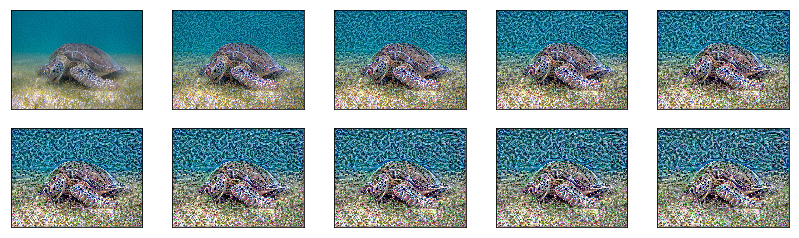

In [25]:
best, best_loss,c_loss,s_loss = run_style_transfer(content_path,style_path, num_iterations=100)

In [0]:
def show_results(best_img, content_path, style_path, show_large_final=True):
    plt.figure(figsize=(10, 5))
    content = load_img(content_path) 
    style = load_img(style_path)

    plt.subplot(1, 2, 1)
    imshow(content, 'Content Image')

    plt.subplot(1, 2, 2)
    imshow(style, 'Style Image')

    if show_large_final: 
        plt.figure(figsize=(10, 10))

        plt.imshow(best_img)
        plt.title('Output Image')
        plt.show()

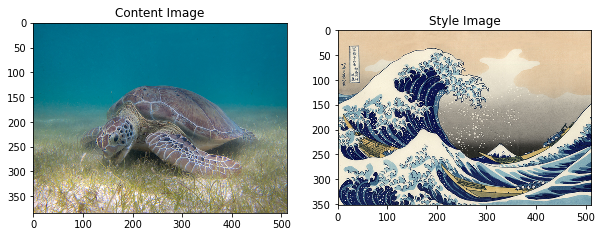

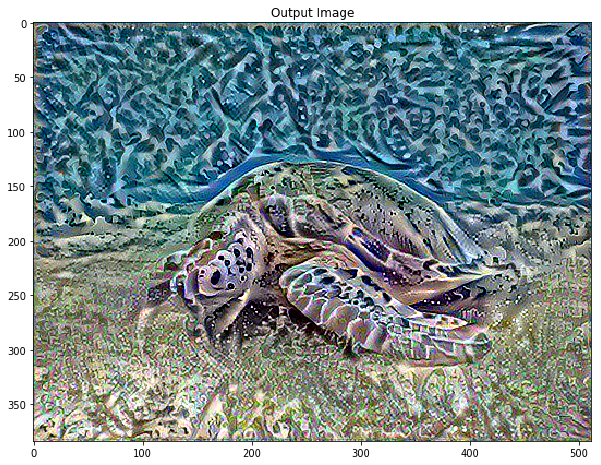

In [27]:
show_results(best, content_path, style_path)

## Test Case #1
>Train using different initialization of theoutput image

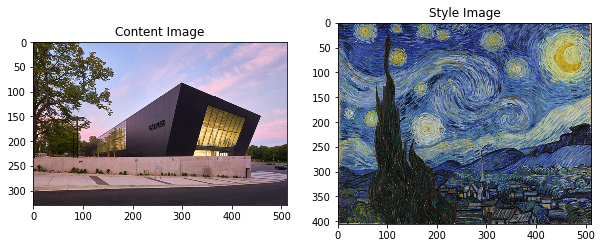

In [28]:
# Set up some global values here
content_path = 'img/content_img/dal_gym.jpg'
style_path = 'img/style_img/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg'

plt.figure(figsize=(10,10))

content = load_img(content_path).astype('uint8')
style = load_img(style_path).astype('uint8')

plt.subplot(1, 2, 1)
imshow(content, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style, 'Style Image')
plt.show()

In [0]:
print(np.shape(content))
print(np.shape(style))

(1, 329, 512, 3)
(1, 406, 512, 3)


### Test 1 Configuration 1
Using random image as initialization of the output image

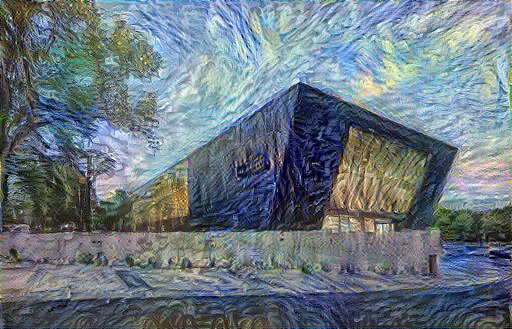

Iteration: 500
Total loss: 2.8922e+06, style loss: 9.0906e+05, content loss: 1.9831e+06, time: 0.0447s


KeyboardInterrupt: ignored

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t1c1, best_loss_t1c1, style_loss_t1c1, content_loss_t1c1 = run_style_transfer(content_path, style_path, num_iterations=5000)

In [0]:
show_results(best_t1c1, content_path, style_path)

In [0]:
plt.plot(content_loss_t1c1)
#plt.yscale('log')

In [0]:
plt.plot(style_loss_t1c1)
plt.yscale('log')


### Test 1 Configuration 2
Use content image as the initialization image

Total time: 416.1588s


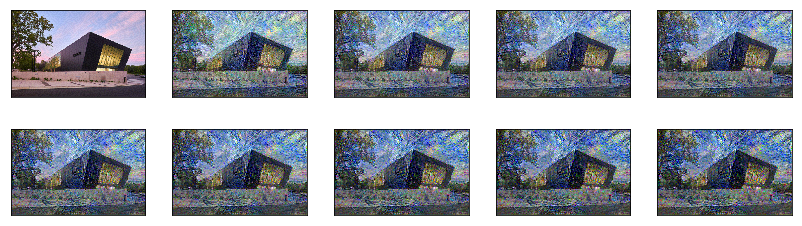

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t1c2, best_loss_t1c2, style_loss_t1c2, content_loss_t1c2 = run_style_transfer(content_path, style_path, num_iterations=5000)

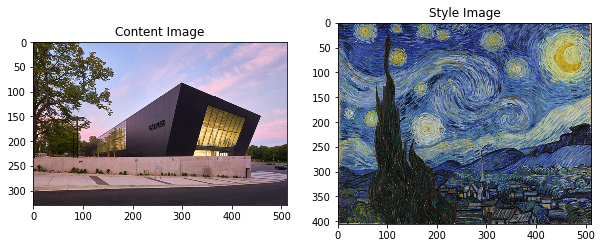

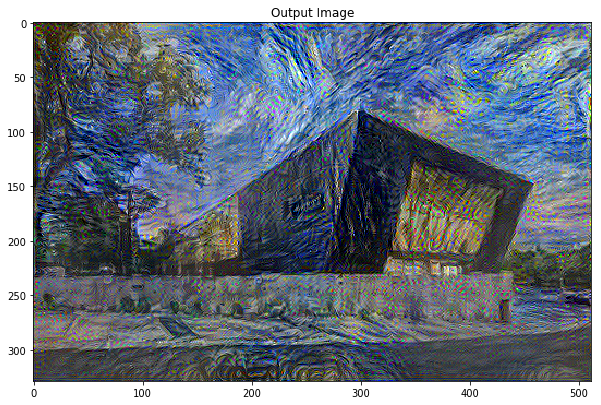

In [0]:
show_results(best_t1c2, content_path, style_path)

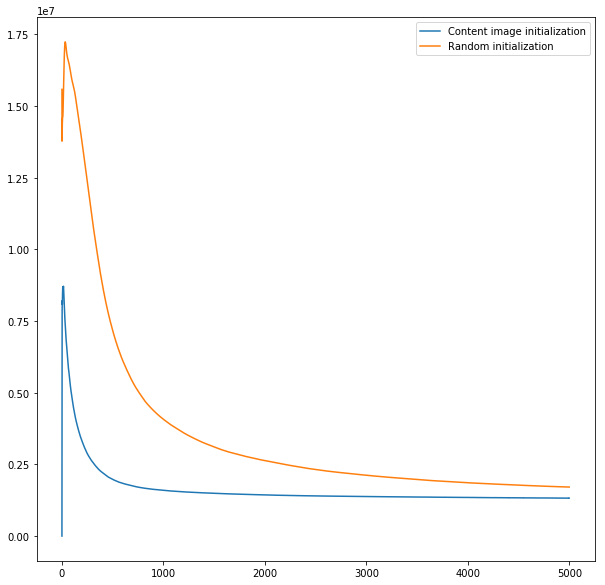

In [0]:
plt.plot(content_loss_t1c2, label = "Content image initialization")
plt.plot(content_loss_t1c1, label = "Random initialization")
plt.legend()
#plt.yscale('log')


In [0]:

print(content_loss_t1c1[-1])
print(style_loss_t1c1[-1])

print(content_loss_t1c2[-1])
print(style_loss_t1c2[-1])

print(content_loss_t1c2[800])
print(style_loss_t1c2[1500])


tf.Tensor(1710332.0, shape=(), dtype=float32)
tf.Tensor(693406.06, shape=(), dtype=float32)
tf.Tensor(1324507.1, shape=(), dtype=float32)
tf.Tensor(622669.44, shape=(), dtype=float32)
tf.Tensor(1677954.4, shape=(), dtype=float32)
tf.Tensor(699728.4, shape=(), dtype=float32)


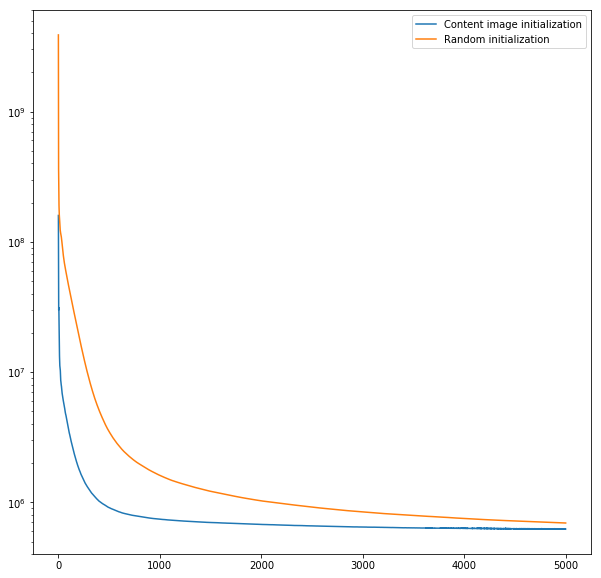

In [0]:
plt.plot(style_loss_t1c2,label = "Content image initialization")
plt.plot(style_loss_t1c1[0:5000], label = "Random initialization")
plt.legend()


plt.yscale('log')

In [0]:
plt.figure(figsize=(8,6))
plt.plot(np.add(style_loss_t1c2,content_loss_t1c2),label = "Content image initialization")
plt.plot(np.add(style_loss_t1c1, content_loss_t1c1), label = "Random initialization")
plt.legend(prop={'size': 15})
plt.plot([5000, 0], [content_loss_t1c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

NameError: ignored

<Figure size 576x432 with 0 Axes>

In [0]:
print(content_loss_t1c1[-1]+style_loss_t1c1[-1])


print(content_loss_t1c2[-1]+style_loss_t1c2[-1])


print(content_loss_t1c2[800]+style_loss_t1c2[800])
print()

tf.Tensor(2403738.0, shape=(), dtype=float32)
tf.Tensor(1947176.5, shape=(), dtype=float32)
tf.Tensor(2454753.5, shape=(), dtype=float32)



### Test 1 Configuration 3
Use content layer as initialization output image with less iteration

Total time: 83.7846s


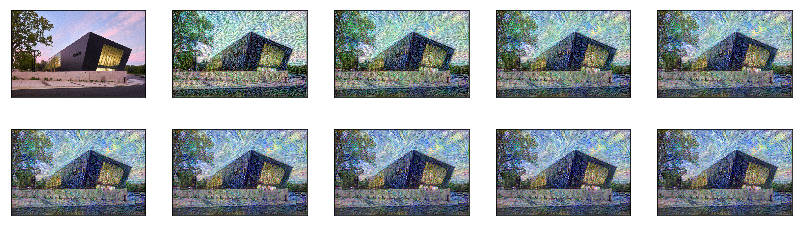

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t1c3, best_loss_t1c3, style_loss_t1c3, content_loss_t1c3 = run_style_transfer(content_path, style_path, num_iterations=1000)

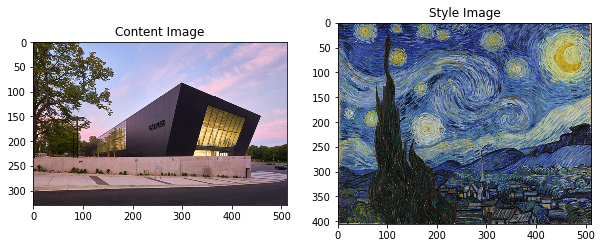

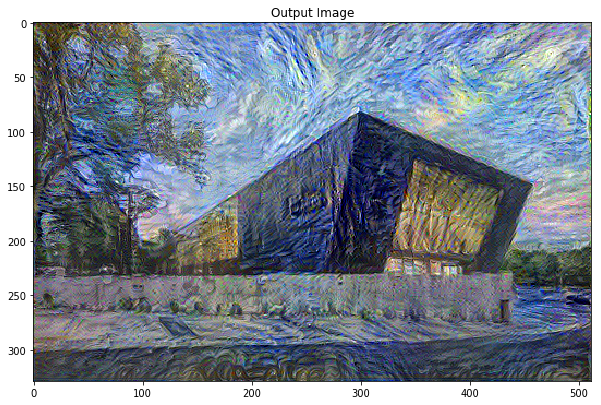

In [0]:
show_results(best_t1c3, content_path, style_path)

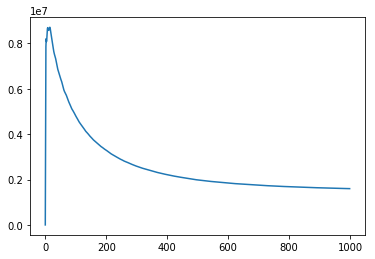

In [0]:
plt.plot(content_loss_t1c3)

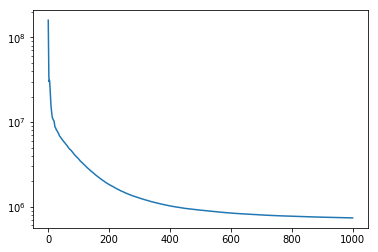

In [0]:
plt.plot(style_loss_t1c3)
plt.yscale('log')

### Test 1 Configuration 4

Total time: 153.6623s


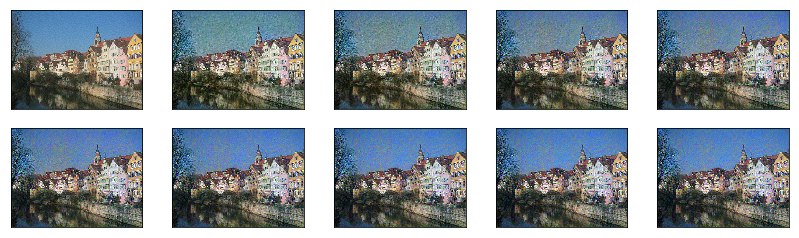

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block4_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t1c4, best_loss_t1c4, style_loss_t1c4, content_loss_t1c4 = run_style_transfer(content_path, style_path, num_iterations=1000)

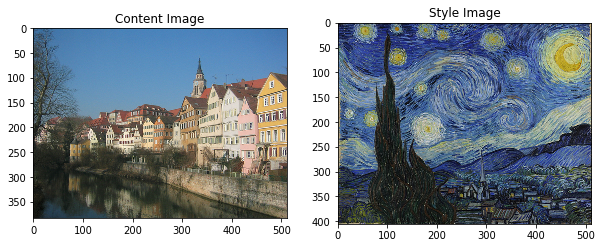

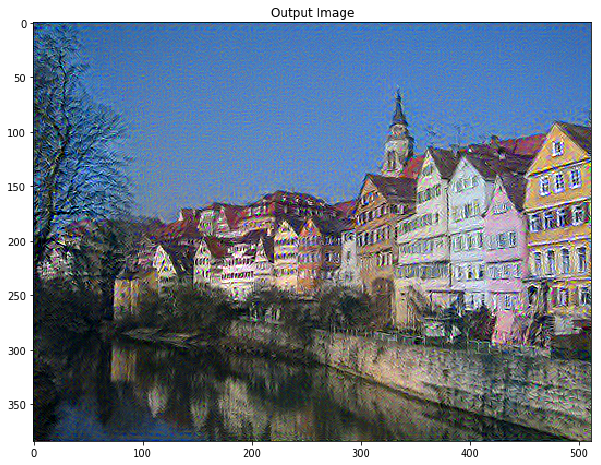

In [0]:
show_results(best_t1c4, content_path, style_path)

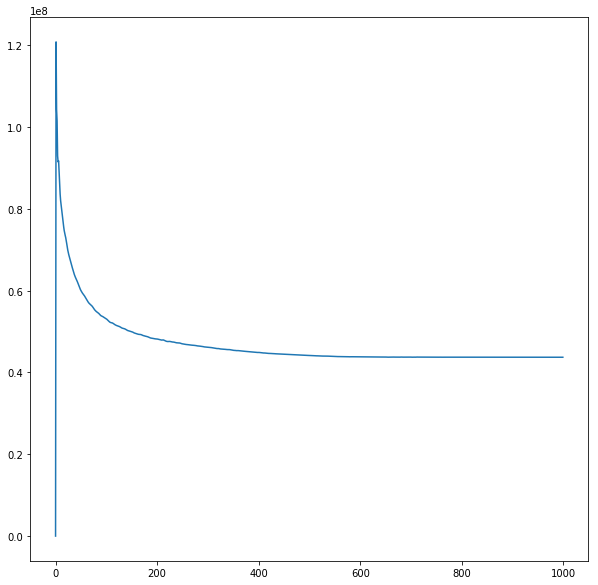

In [0]:
plt.plot(content_loss_t1c4)

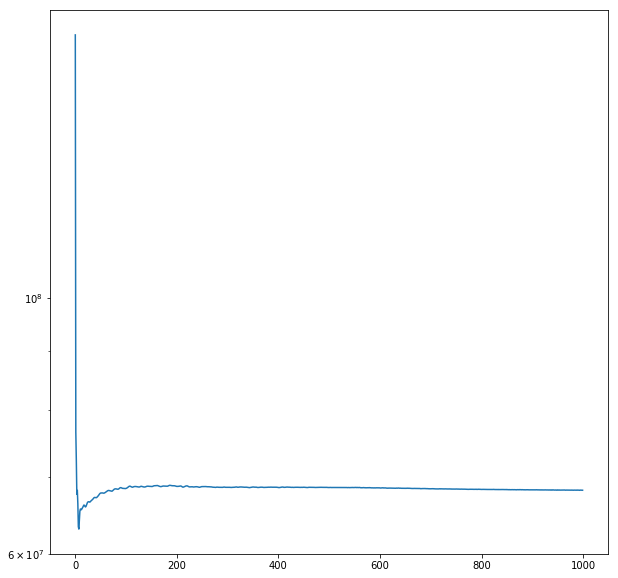

In [0]:
plt.plot(style_loss_t1c4)
plt.yscale('log')

### Test 1 Configuration 5

Total time: 153.3399s


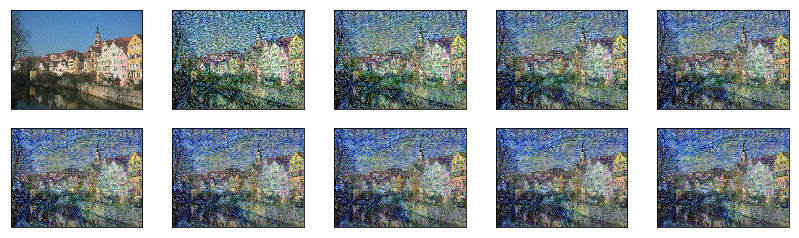

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t1c5, best_loss_t1c5, style_loss_t1c5, content_loss_t1c5 = run_style_transfer(content_path, style_path, num_iterations=1000)

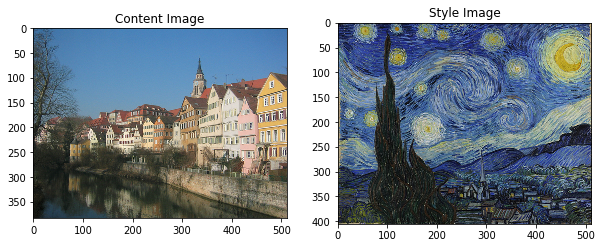

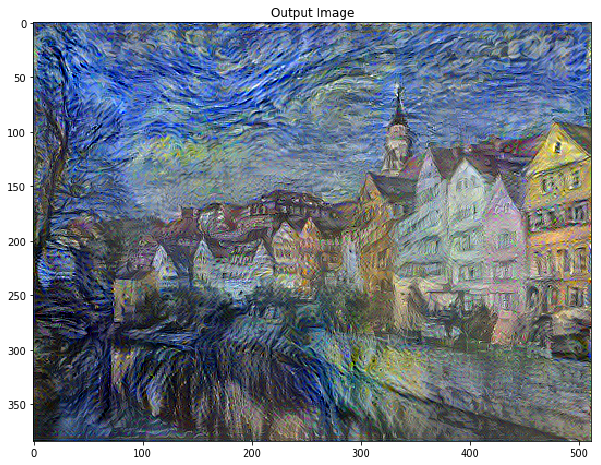

In [0]:
show_results(best_t1c5, content_path, style_path)

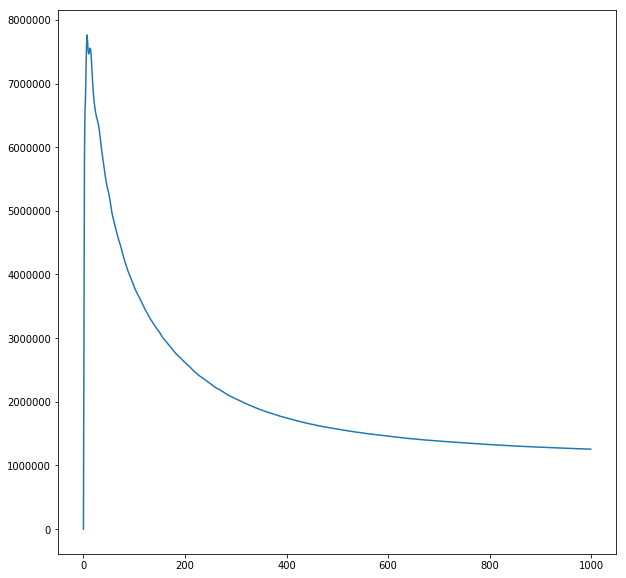

In [0]:
plt.plot(content_loss_t1c5)

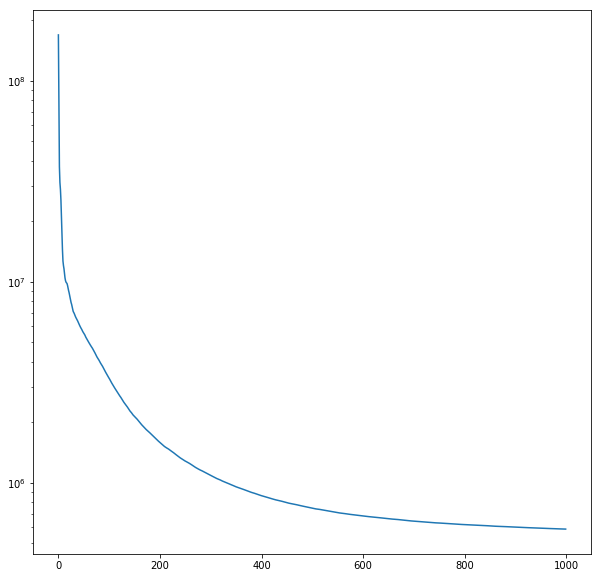

In [0]:
plt.plot(style_loss_t1c5)
plt.yscale('log')

## Test Case #2
>Train using different content layer

### Configuration 1

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

Total time: 97.0551s


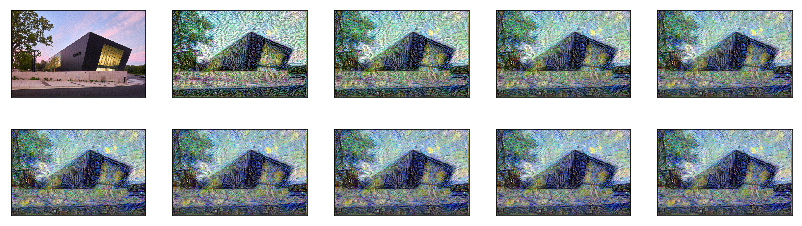

In [30]:
best_t2c1, best_loss_t2c1, style_loss_t2c1, content_loss_t2c1 = run_style_transfer(content_path, style_path, num_iterations=1000)

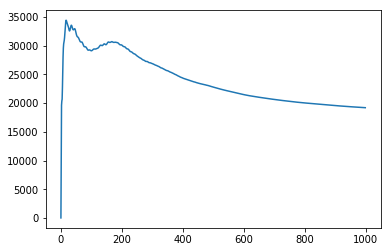

In [0]:
 plt.plot(content_loss_t2c1)

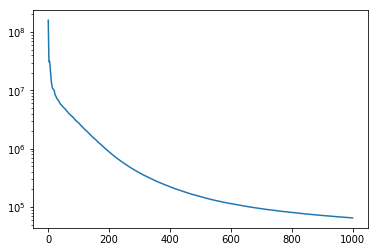

In [0]:
plt.plot(style_loss_t2c1 )
plt.yscale('log')

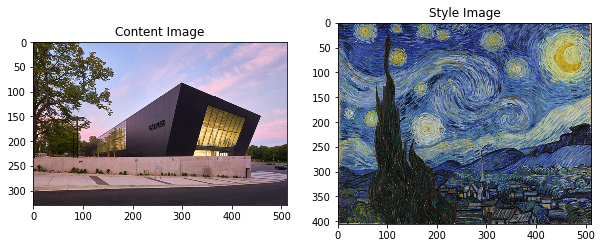

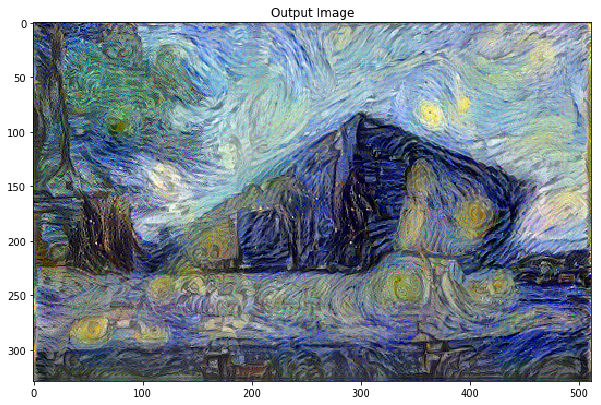

In [0]:
show_results(best_t2c1, content_path, style_path)

### Configuration 2

Total time: 90.2105s


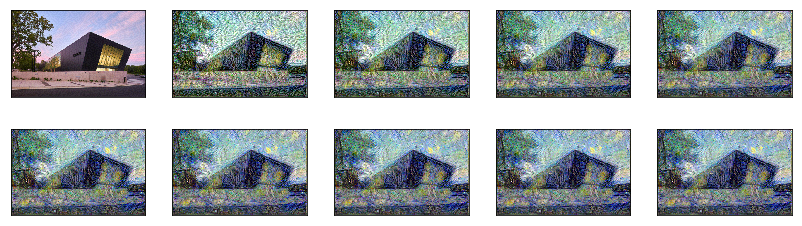

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_pool'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)


best_t2c2, best_loss_t2c2, style_loss_t2c2, content_loss__t2c2 = run_style_transfer(content_path, style_path, num_iterations=1000)

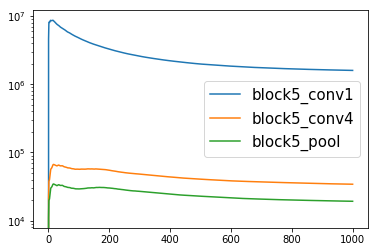

In [0]:
plt.plot( content_loss_t1c3, label = "block5_conv1")
plt.plot(content_loss__t2c2,label = "block5_conv4")
plt.plot( content_loss_t2c1, label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

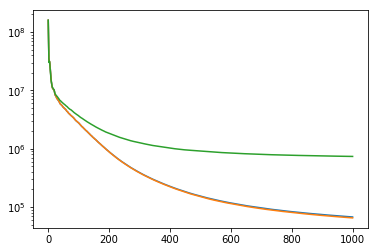

In [0]:
plt.plot(style_loss_t2c2)
plt.plot(style_loss_t2c1)
plt.plot(style_loss_t1c3)
plt.yscale('log')

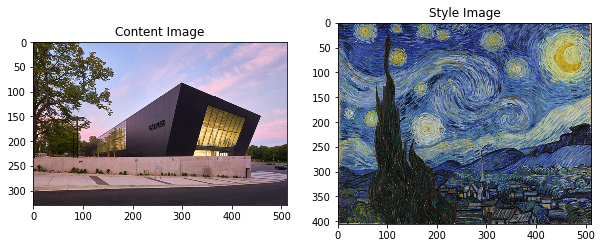

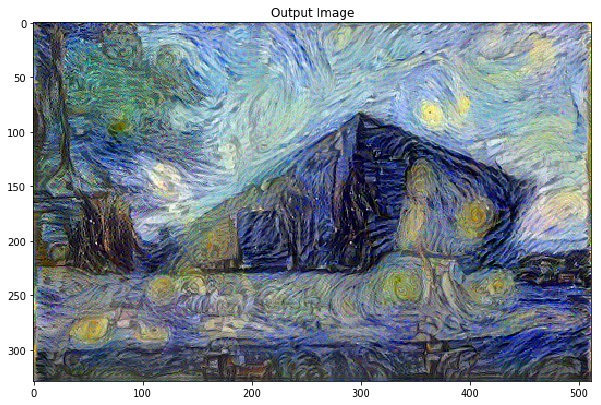

In [0]:
show_results(best_t2c2, content_path, style_path)

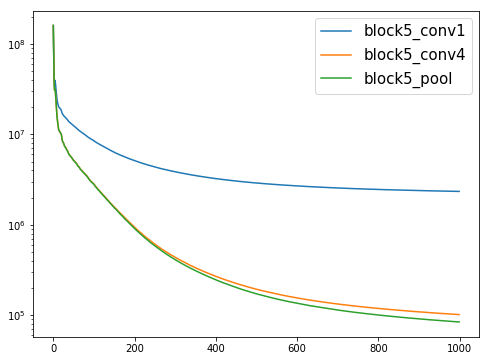

In [0]:
plt.figure(figsize=(8,6))
plt.plot(np.add(style_loss_t1c3, content_loss_t1c3), label = "block5_conv1")
plt.plot(np.add(style_loss_t2c2,content_loss__t2c2),label = "block5_conv4")
plt.plot(np.add(style_loss_t2c1, content_loss_t2c1), label = "block5_pool")
plt.legend(prop={'size': 15})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

In [0]:
print("Is there a GPU available: "),
print(tf.test.is_gpu_available())

Is there a GPU available: 
True


### Configuration 3

Total time: 83.3853s


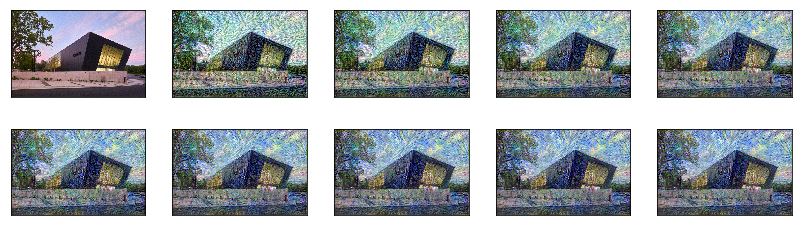

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv1'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t2c3, best_loss_t2c3, style_loss_t2c3, content_loss__t2c3 = run_style_transfer(content_path, style_path, num_iterations=1000)

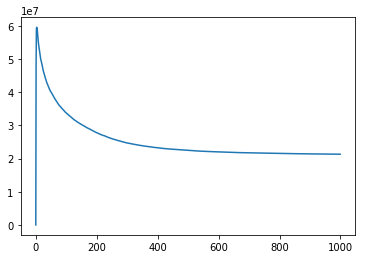

In [0]:
plt.plot(content_loss__t2c3)

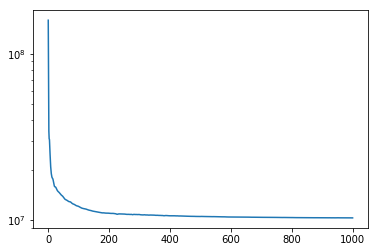

In [0]:
plt.plot(style_loss_t2c3)
plt.yscale('log')

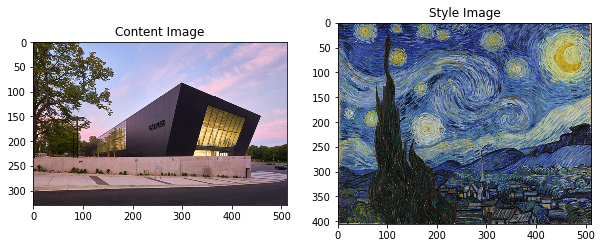

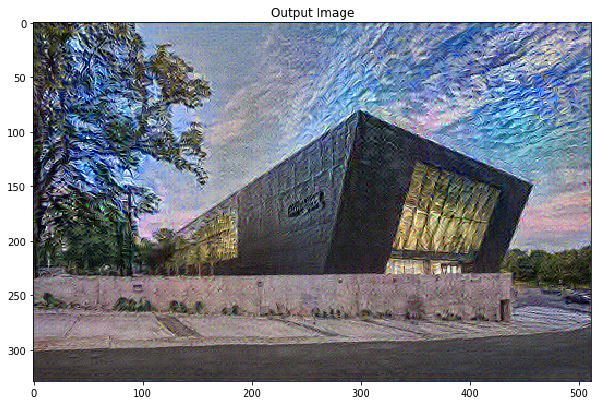

In [0]:
show_results(best_t2c3, content_path, style_path)

### Configuration 4

Total time: 97.1892s


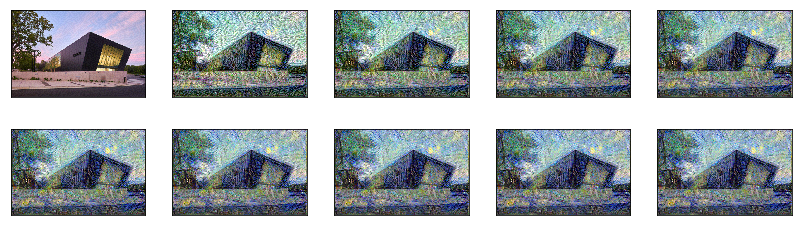

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv3'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t2c4, best_loss_t2c4, style_loss_t2c4, content_loss__t2c4 = run_style_transfer(content_path, style_path, num_iterations=1000)

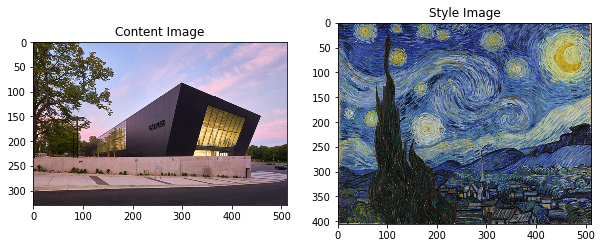

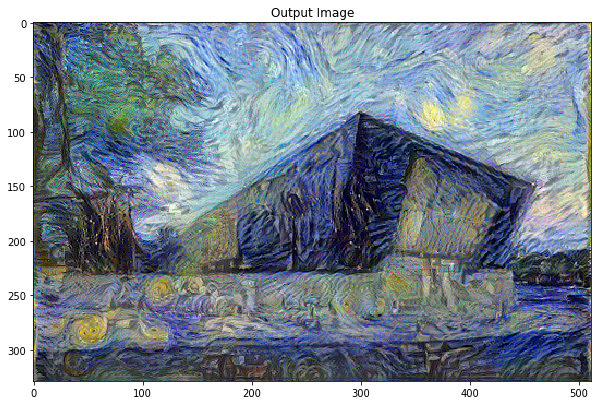

In [0]:
show_results(best_t2c4, content_path, style_path)

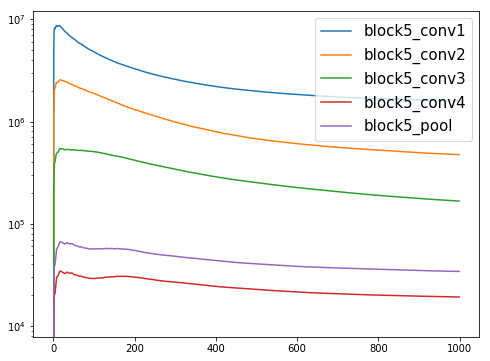

In [0]:
plt.figure(figsize=(8,6))
plt.plot(content_loss__t2c3, label = "block5_conv1")
plt.plot(content_loss__t2c5, label = "block5_conv2")
plt.plot(content_loss__t2c4,label = "block5_conv3")
plt.plot(content_loss_t2c1, label = "block5_conv4")
plt.plot(content_loss__t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

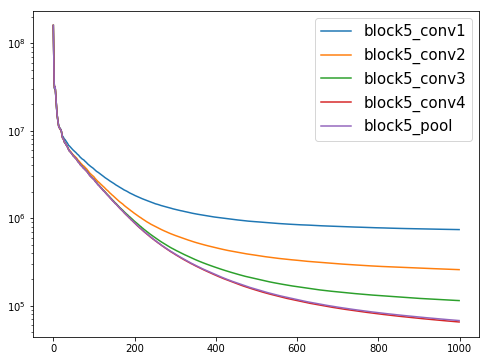

In [0]:
plt.figure(figsize=(8,6))
plt.plot( style_loss_t2c3, label = "block5_conv1")
plt.plot( style_loss_t2c5, label = "block5_conv2")
plt.plot(style_loss_t2c4,label = "block5_conv3")
plt.plot( style_loss_t2c1, label = "block5_conv4")
plt.plot(style_loss_t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

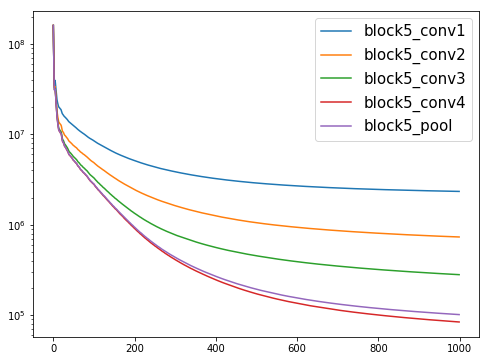

In [0]:
plt.figure(figsize=(8,6))
plt.plot( np.add(style_loss_t1c3,content_loss_t1c3), label = "block5_conv1")
plt.plot( np.add(style_loss_t2c5,content_loss__t2c5), label = "block5_conv2")
plt.plot(np.add(style_loss_t2c4,content_loss__t2c4),label = "block5_conv3")
plt.plot( np.add(style_loss_t2c1,content_loss_t2c1), label = "block5_conv4")
plt.plot(np.add(style_loss_t2c2,content_loss__t2c2),label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

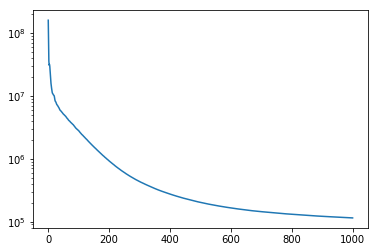

In [0]:
plt.plot(style_loss_t2c4)
plt.yscale('log')

### Configuration 5

Total time: 90.5332s


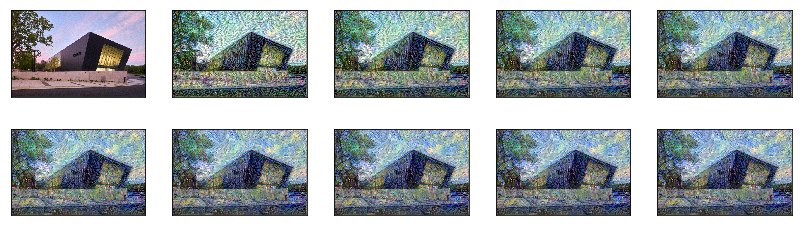

In [0]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1'
               ]

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t2c5, best_loss_t2c5, style_loss_t2c5, content_loss__t2c5 = run_style_transfer(content_path, style_path, num_iterations=1000)

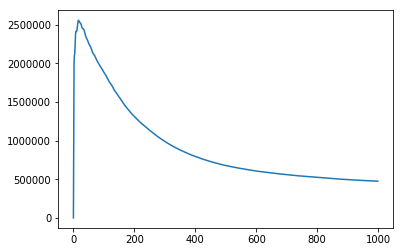

In [0]:
plt.plot(content_loss__t2c5)

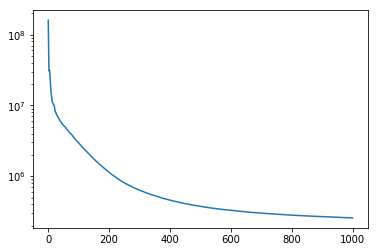

In [0]:
plt.plot(style_loss_t2c5)
plt.yscale('log')

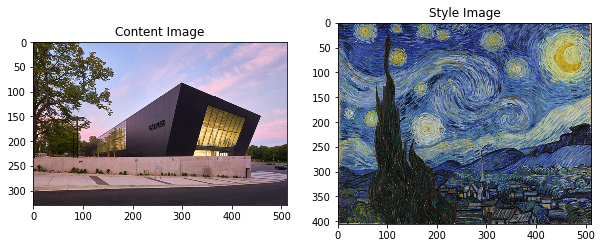

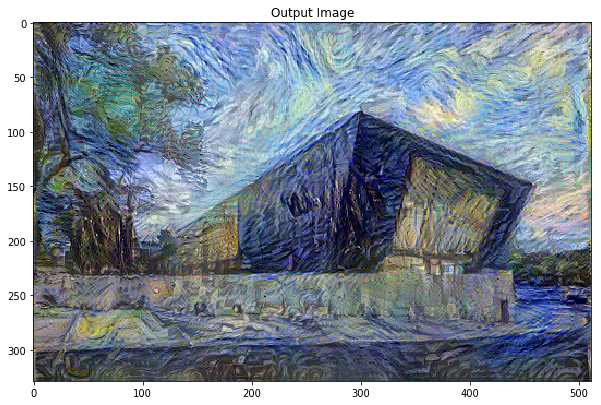

In [0]:
show_results(best_t2c5, content_path, style_path)


## test case 3

### configuration 1

Total time: 127.0422s


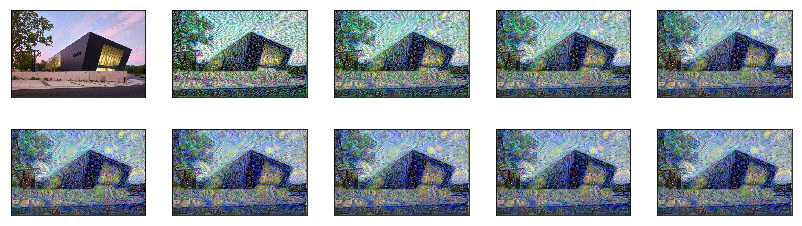

In [32]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block3_conv3',
                'block3_conv4',
                'block4_conv1',
                'block4_conv2',
                'block4_conv3',
                'block4_conv4',
                'block5_conv1',
                'block5_conv2',
                'block5_conv3',
                'block5_conv4',
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c1, best_loss_t3c1, style_loss_t3c1,content_loss_t3c1 = run_style_transfer(content_path,style_path, num_iterations=1000)

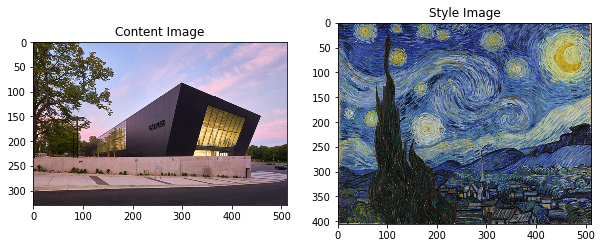

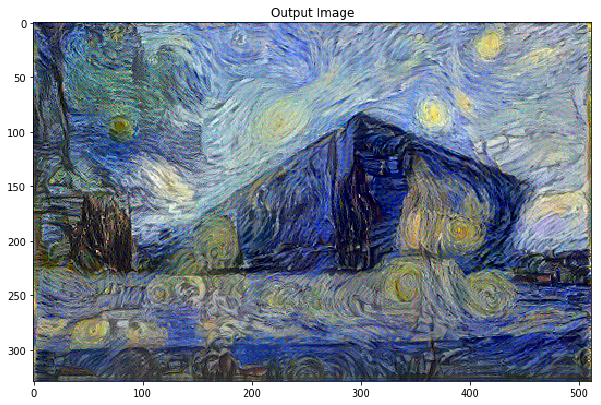

In [33]:
show_results(best_t3c1, content_path, style_path)

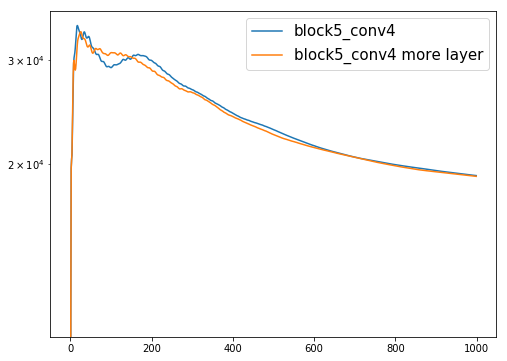

In [34]:
plt.figure(figsize=(8,6))
plt.plot(content_loss_t2c1, label = "block5_conv4")
plt.plot(content_loss_t3c1, label = "block5_conv4 more layer")
#plt.plot(content_loss__t2c3, label = "block5_conv1")
#plt.plot(content_loss__t2c5, label = "block5_conv2")
#plt.plot(content_loss__t2c4,label = "block5_conv3")
#plt.plot(content_loss__t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

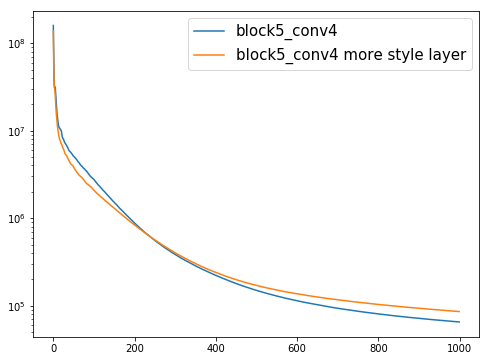

In [35]:
plt.figure(figsize=(8,6))
plt.plot( style_loss_t2c1, label = "block5_conv4")
plt.plot( style_loss_t3c1, label = "block5_conv4 more style layer")
#plt.plot( style_loss_t2c5, label = "block5_conv2")
#plt.plot(style_loss_t2c4,label = "block5_conv3")
#plt.plot(style_loss_t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

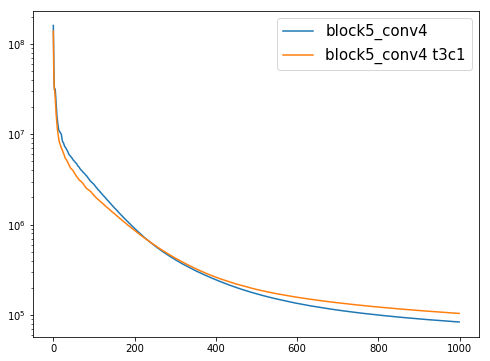

In [36]:
plt.figure(figsize=(8,6))
plt.plot(np.add(style_loss_t2c1, content_loss_t2c1), label = "block5_conv4")
plt.plot(np.add(style_loss_t3c1, content_loss_t3c1), label = "block5_conv4 t3c1")
#plt.plot(np.add(style_loss_t2c2,content_loss__t2c2),label = "block5_conv4")
plt.legend(prop={'size': 15})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

In [37]:
print(best_loss_t3c1)
print(best_loss_t2c1)

tf.Tensor(104688.37, shape=(), dtype=float32)
tf.Tensor(84188.7, shape=(), dtype=float32)


### configure 2

Total time: 88.4458s


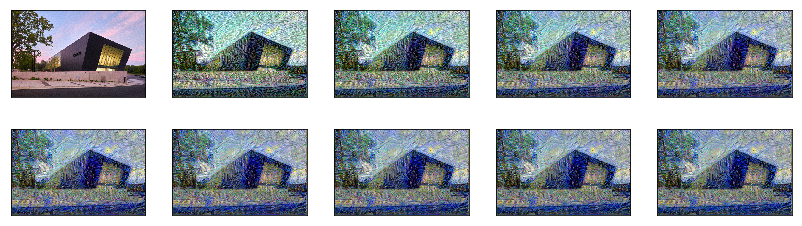

In [38]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = [
                'block1_conv2',
                'block2_conv2',
                'block3_conv4',
                'block4_conv4',
                'block5_conv4'
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c2, best_loss_t3c2, style_loss_t3c2,content_loss_t3c2 = run_style_transfer(content_path,style_path, num_iterations=1000)

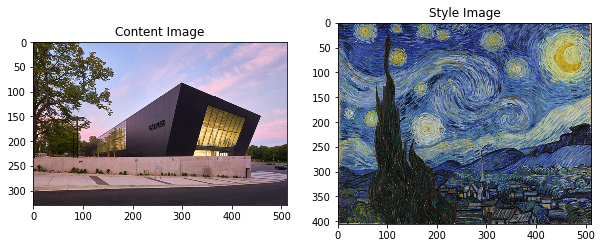

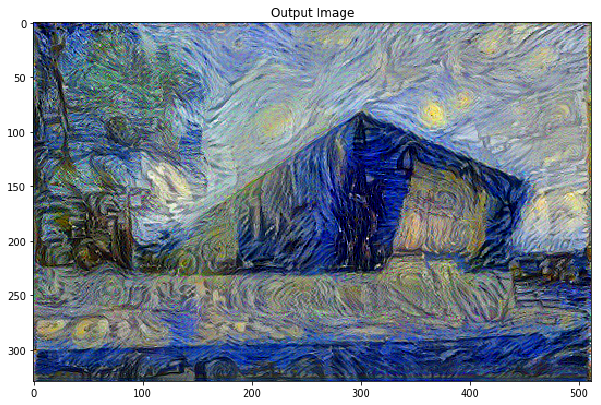

tf.Tensor(58178.586, shape=(), dtype=float32)


In [39]:
show_results(best_t3c2, content_path, style_path)
print(best_loss_t3c2)

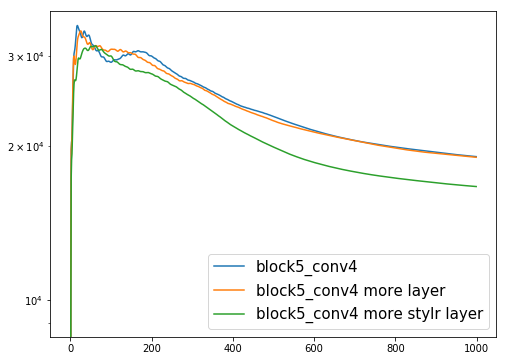

In [40]:
plt.figure(figsize=(8,6))
plt.plot(content_loss_t2c1, label = "block5_conv4")
plt.plot(content_loss_t3c1, label = "block5_conv4 more layer")
plt.plot(content_loss_t3c2, label = "block5_conv4 more stylr layer")
#plt.plot(content_loss__t2c5, label = "block5_conv2")
#plt.plot(content_loss__t2c4,label = "block5_conv3")
#plt.plot(content_loss__t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

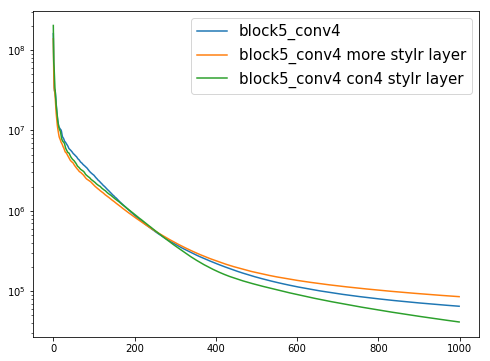

In [41]:
plt.figure(figsize=(8,6))
plt.plot( style_loss_t2c1, label = "block5_conv4")
plt.plot( style_loss_t3c1, label = "block5_conv4 more stylr layer")
plt.plot( style_loss_t3c2, label = "block5_conv4 con4 stylr layer")
#plt.plot(style_loss_t2c4,label = "block5_conv3")
#plt.plot(style_loss_t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

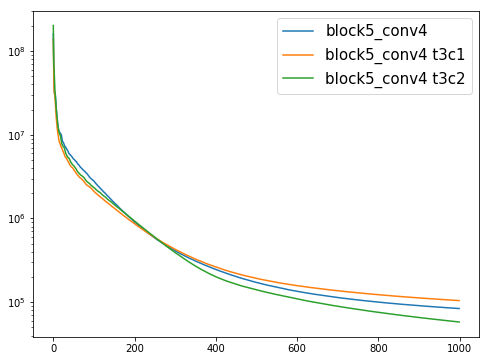

In [42]:
plt.figure(figsize=(8,6))
plt.plot(np.add(style_loss_t2c1, content_loss_t2c1), label = "block5_conv4")
plt.plot(np.add(style_loss_t3c1, content_loss_t3c1), label = "block5_conv4 t3c1")
plt.plot(np.add(style_loss_t3c2,content_loss_t3c2),label = "block5_conv4 t3c2")
plt.legend(prop={'size': 15})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

### configure 3

Total time: 93.8218s


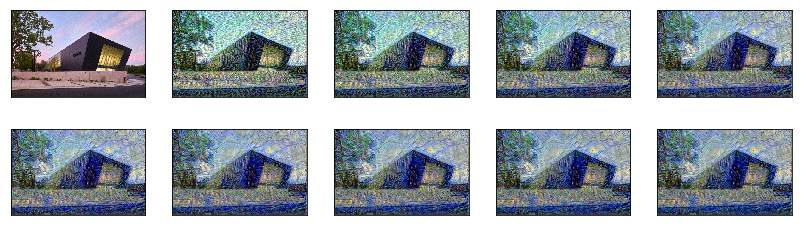

In [43]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv2',
                'block3_conv4',
                'block4_conv4',
                'block5_conv4',
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c3, best_loss_t3c3, style_loss_t3c3,content_loss_t3c3 = run_style_transfer(content_path,style_path, num_iterations=1000)

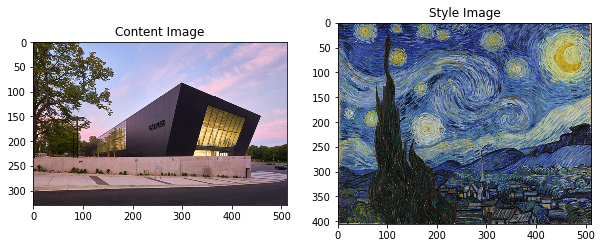

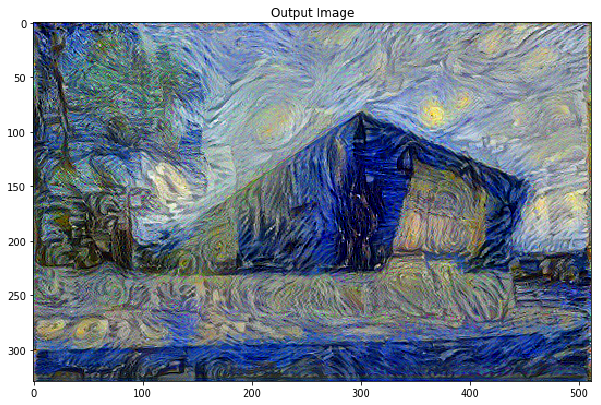

In [44]:
show_results(best_t3c3, content_path, style_path)

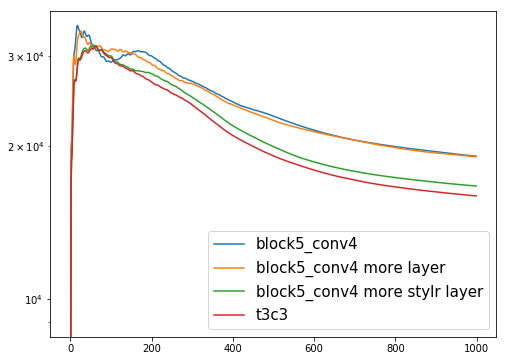

In [45]:
plt.figure(figsize=(8,6))
plt.plot(content_loss_t2c1, label = "block5_conv4")
plt.plot(content_loss_t3c1, label = "block5_conv4 more layer")
plt.plot(content_loss_t3c2, label = "block5_conv4 more stylr layer")
plt.plot(content_loss_t3c3, label = "t3c3")
#plt.plot(content_loss__t2c4,label = "block5_conv3")
#plt.plot(content_loss__t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

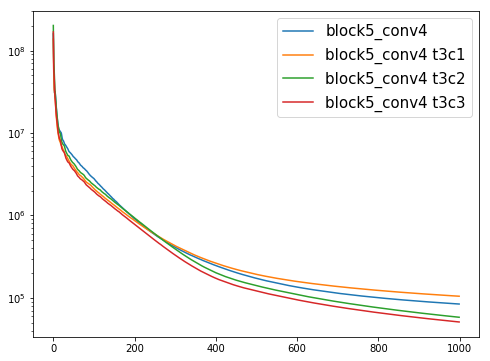

In [46]:
plt.figure(figsize=(8,6))
plt.plot(np.add(style_loss_t2c1, content_loss_t2c1), label = "block5_conv4")
plt.plot(np.add(style_loss_t3c1, content_loss_t3c1), label = "block5_conv4 t3c1")
plt.plot(np.add(style_loss_t3c2,content_loss_t3c2),label = "block5_conv4 t3c2")
plt.plot(np.add(style_loss_t3c3,content_loss_t3c3),label = "block5_conv4 t3c3")

plt.legend(prop={'size': 15})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

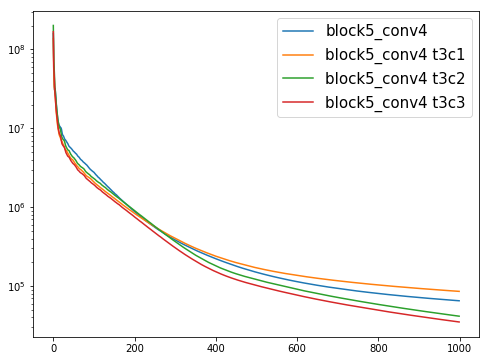

In [47]:
plt.figure(figsize=(8,6))
plt.plot( style_loss_t2c1, label = "block5_conv4")
plt.plot( style_loss_t3c1, label = "block5_conv4 t3c1")
plt.plot( style_loss_t3c2, label = "block5_conv4 t3c2")
plt.plot(style_loss_t3c3,label = "block5_conv4 t3c3")
#plt.plot(style_loss_t2c2,label = "block5_pool")
plt.legend(prop={'size': 15})
plt.yscale('log')

### configuration 4

Total time: 84.4070s


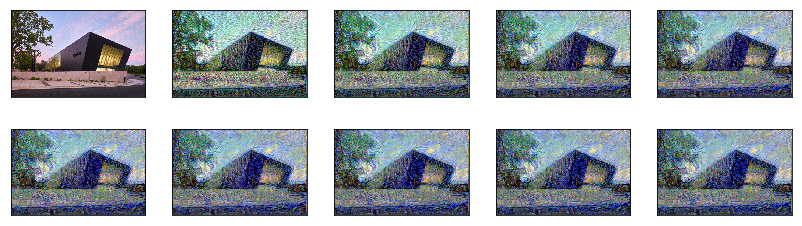

In [48]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = [
                
                'block1_pool',
             
                'block2_pool',
              
                'block3_pool',
              
                'block4_pool',
               
                'block5_pool'
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c4, best_loss_t3c4, style_loss_t3c4,content_loss_t3c4 = run_style_transfer(content_path,style_path, num_iterations=1000)

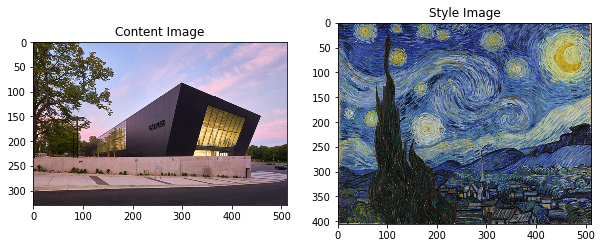

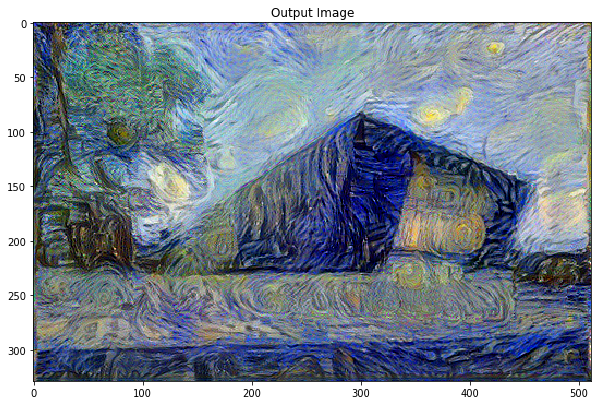

In [49]:
show_results(best_t3c4, content_path, style_path)

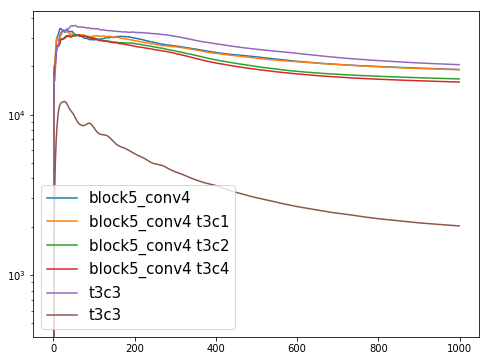

In [63]:
plt.figure(figsize=(8,6))
plt.plot( content_loss_t2c1, label = "block5_conv4")
plt.plot( content_loss_t3c1, label = "block5_conv4 t3c1")
plt.plot( content_loss_t3c2, label = "block5_conv4 t3c2")
plt.plot(content_loss_t3c3,label = "block5_conv4 t3c4")
plt.plot(content_loss_t3c4,label = "t3c3")
plt.plot(content_loss_t3c5,label = "t3c3")
plt.legend(prop={'size': 15})
plt.yscale('log')

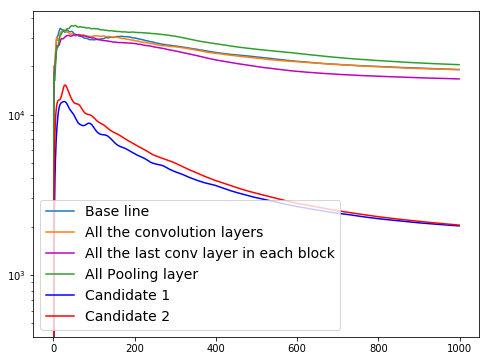

In [64]:
plt.figure(figsize=(8,6))
plt.plot((content_loss_t2c1 ), label = "Base line")
plt.plot((content_loss_t3c1), label = "All the convolution layers")
plt.plot((content_loss_t3c2),'m',label = "All the last conv layer in each block")
#plt.plot((content_loss_t3c3),label = "All the last conv layer in each block + bolck1_conv2")
plt.plot((content_loss_t3c4),label = "All Pooling layer")
plt.plot((content_loss_t3c5),'b',label = "Candidate 1")
#plt.plot((content_loss_t3c6),label = "All Pooling layer+conv2")
#plt.plot((content_loss_t3c7),label = "All Pooling layer+conv2")
plt.plot((content_loss_t3c8),'r-',label = "Candidate 2")


plt.legend(prop={'size': 14})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

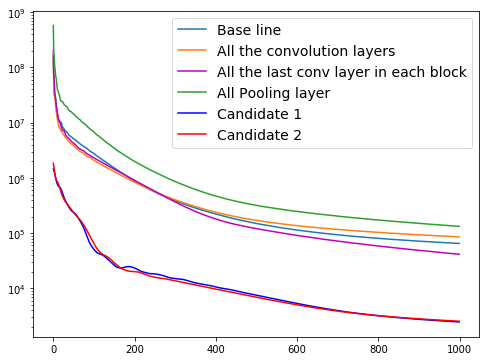

In [65]:
plt.figure(figsize=(8,6))
plt.plot((style_loss_t2c1 ), label = "Base line")
plt.plot((style_loss_t3c1), label = "All the convolution layers")
plt.plot((style_loss_t3c2),'m',label = "All the last conv layer in each block")
#plt.plot((style_loss_t3c3),label = "All the last conv layer in each block + bolck1_conv2")
plt.plot((style_loss_t3c4),label = "All Pooling layer")
plt.plot((style_loss_t3c5),'b',label = "Candidate 1")
#plt.plot((style_loss_t3c6),label = "All Pooling layer+conv2")
#plt.plot((style_loss_t3c7),label = "All Pooling layer+conv2")
plt.plot((style_loss_t3c8),'r-',label = "Candidate 2")


plt.legend(prop={'size': 14})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

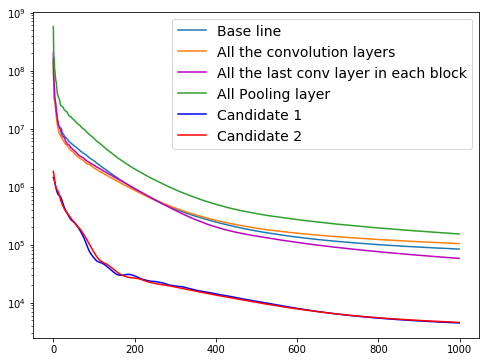

In [66]:
plt.figure(figsize=(8,6))
plt.plot(np.add(style_loss_t2c1, content_loss_t2c1), label = "Base line")
plt.plot(np.add(style_loss_t3c1, content_loss_t3c1), label = "All the convolution layers")
plt.plot(np.add(style_loss_t3c2,content_loss_t3c2),'m',label = "All the last conv layer in each block")
#plt.plot(np.add(style_loss_t3c3,content_loss_t3c3),label = "All the last conv layer in each block + bolck1_conv2")
plt.plot(np.add(style_loss_t3c4,content_loss_t3c4),label = "All Pooling layer")
plt.plot(np.add(style_loss_t3c5,content_loss_t3c5),'b',label = "Candidate 1")
#plt.plot(np.add(style_loss_t3c6,content_loss_t3c6),label = "All Pooling layer+conv2")
#plt.plot(np.add(style_loss_t3c7,content_loss_t3c7),label = "All Pooling layer+conv2")
plt.plot(np.add(style_loss_t3c8,content_loss_t3c8),'r-',label = "Candidate 2")


plt.legend(prop={'size': 14})
#plt.plot([5000, 0], [content_loss_t2c1[-1]+style_loss_t1c1[-1], content_loss_t1c1[-1]+style_loss_t1c1[-1]], 'r--', lw=1)
plt.yscale('log')

In [67]:
a = np.add(style_loss_t3c8,content_loss_t3c8)
a[-1]

4594.34

In [68]:
content_loss_t3c8[-1]

<tf.Tensor: id=5675884, shape=(), dtype=float32, numpy=2048.1333>

In [74]:
(1-style_loss_t3c8[-1]/style_loss_t2c1[-1])*100

<tf.Tensor: id=5740268, shape=(), dtype=float32, numpy=96.089554>

In [76]:
(1-(best_loss_t3c8)/best_loss_t2c1)*100

<tf.Tensor: id=5740277, shape=(), dtype=float32, numpy=94.54281>

In [73]:
style_loss_t2c1[-1]

<tf.Tensor: id=563060, shape=(), dtype=float32, numpy=65112.91>

### Configuration 5

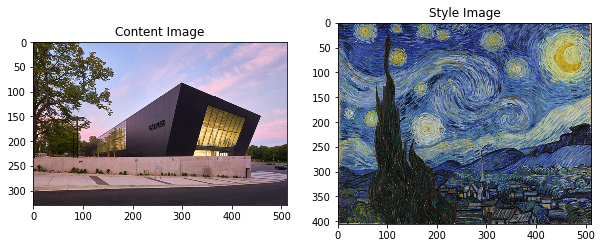

In [51]:
# Set up some global values here
#content_path = 'img/content_img/night_cloud.jpg'
#style_path = 'img/style_img/1024px-Van_Gogh_-_Starry_Night_-_Google_Art_Project.jpg'

plt.figure(figsize=(10,10))

content = load_img(content_path).astype('uint8')
style = load_img(style_path).astype('uint8')

plt.subplot(1, 2, 1)
imshow(content, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style, 'Style Image')
plt.show()

Total time: 97.4182s


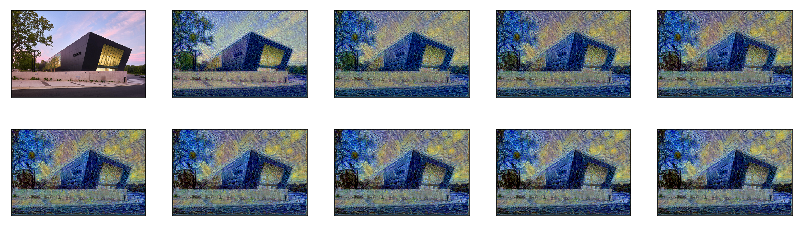

In [52]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = [
                'block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block3_conv1',
                'block4_conv4',
                'block5_conv4'
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c5, best_loss_t3c5, style_loss_t3c5,content_loss_t3c5 = run_style_transfer(content_path,style_path, num_iterations=1000)

In [53]:
best_loss_t3c5

<tf.Tensor: id=3864506, shape=(), dtype=float32, numpy=4491.5684>

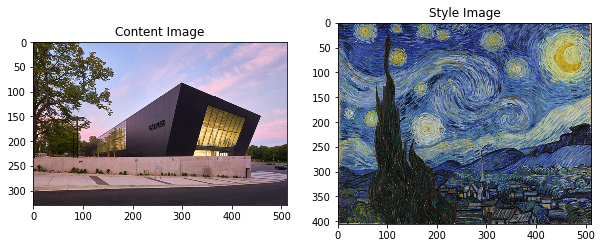

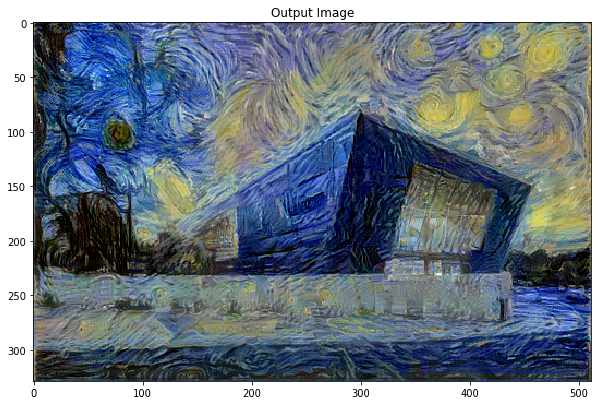

In [54]:
show_results(best_t3c5, content_path, style_path)

### config 6

Total time: 100.1688s


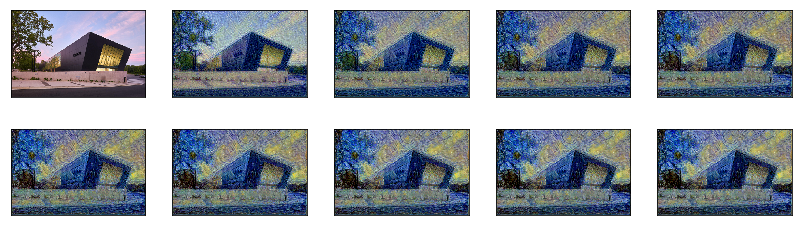

In [55]:
 # Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv1',
                'block4_conv4',
                'block5_conv4'
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c6, best_loss_t3c6, style_loss_t3c6,content_loss_t3c6 = run_style_transfer(content_path,style_path, num_iterations=1000)

In [56]:
best_loss_t3c6

<tf.Tensor: id=4486314, shape=(), dtype=float32, numpy=4415.135>

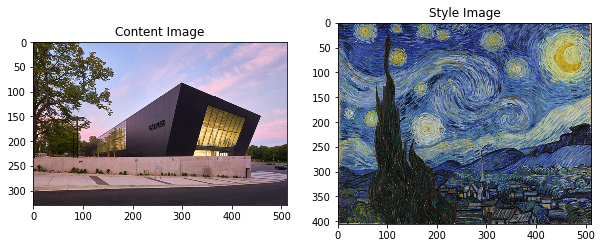

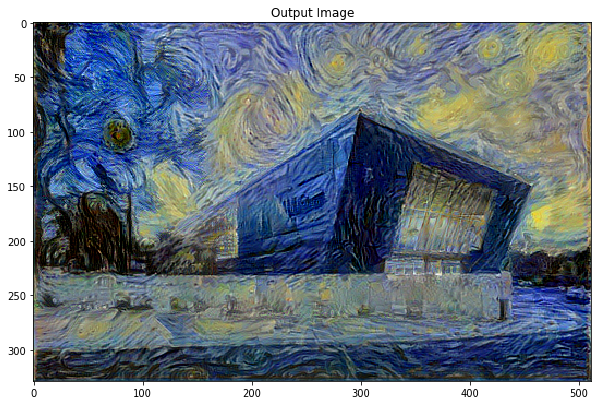

In [57]:
show_results(best_t3c6, content_path, style_path)

### Config 7

Total time: 96.1290s


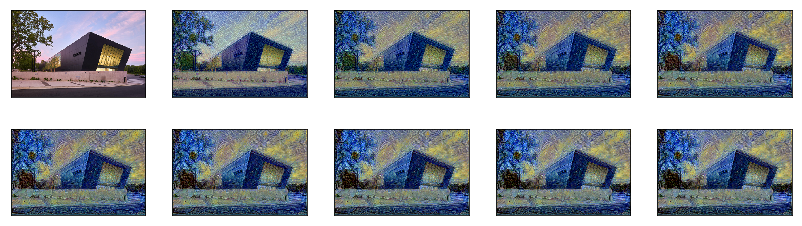

In [58]:
 # Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block4_conv4',
                'block5_conv4'
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c7, best_loss_t3c7, style_loss_t3c7,content_loss_t3c7 = run_style_transfer(content_path,style_path, num_iterations=1000)

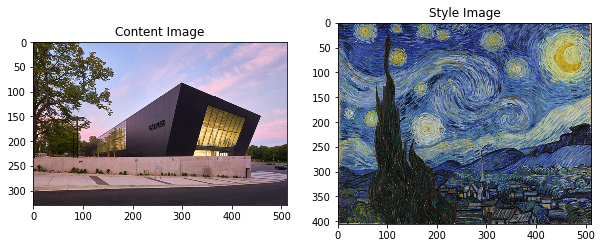

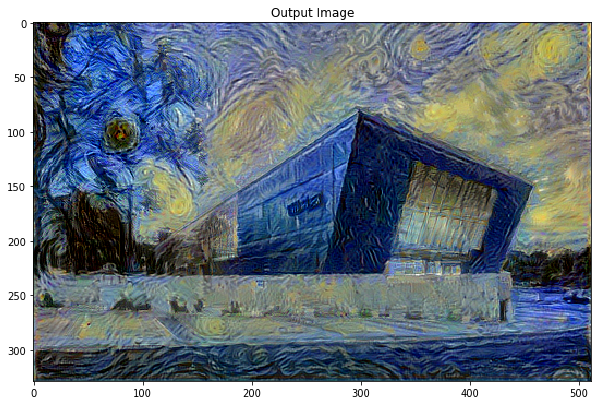

In [59]:
show_results(best_t3c7, content_path, style_path)

### config 8

Total time: 100.2987s


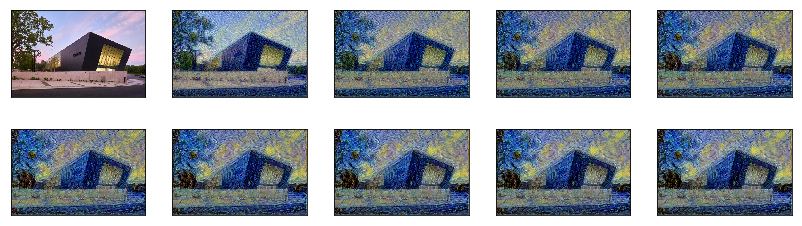

In [60]:
 # Content layer where will pull our feature maps
content_layers = ['block5_conv4'] 

# Style layer we are interested in
style_layers = ['block1_conv1',
                'block1_conv2',
                'block2_conv1',
                'block2_conv2',
                'block3_conv2',
                'block4_conv4',
                'block5_conv4',
               ]


num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

best_t3c8, best_loss_t3c8, style_loss_t3c8,content_loss_t3c8 = run_style_transfer(content_path,style_path, num_iterations=1000)

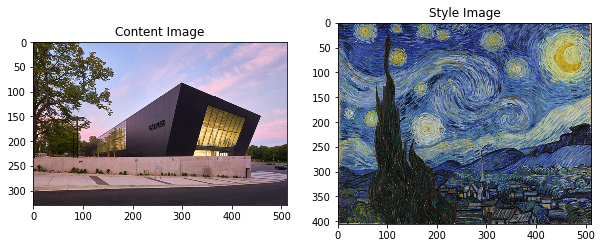

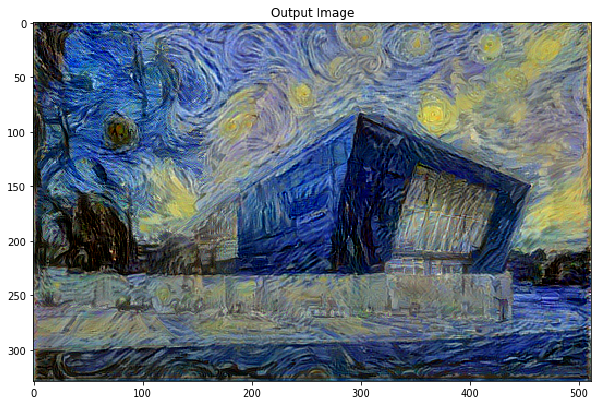

In [61]:
show_results(best_t3c8, content_path, style_path)

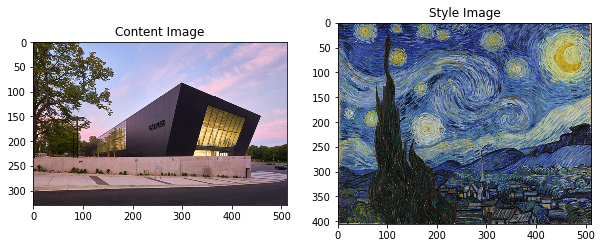

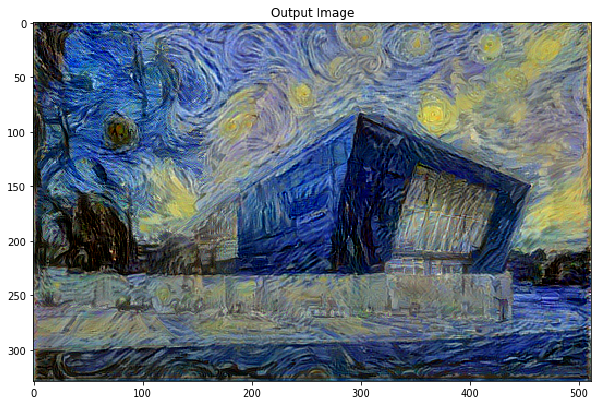

In [62]:
show_results(best_t3c8, content_path, style_path)